Figure 2 - Pancreas Application
----
In this notebook, we apply CellRank to mouse [pancreatic endocrinogenesis](https://dev.biologists.org/content/146/12/dev173849) at E15.5 in development. We compute initial and terminal states as well as lineage probabilities, look into lineage drivers and aggregate cellular fates to a cluster level. 

Changelog
- use MAGIC imputation and Palantir's pseudotime

# Preliminaries

## Import packages

In [1]:
%load_ext autoreload
%autoreload 2

import scvelo as scv
import scanpy.external as sce
import scanpy as sc
import numpy as np
import matplotlib.pyplot as plt
from seaborn import distplot, heatmap
import pandas as pd 

import cellrank as cr
cr.settings.verbosity = 2
scv.settings.verbosity = 3 

In [2]:
# print relevant package versions
scv.logging.print_version()
print(f'cellrank version = {cr.__version__}')
sc.logging.print_header()

Running scvelo 0.2.2 (python 3.8.5) on 2020-09-30 09:42.
cellrank version = 1.0.0-rc.12
scanpy==1.6.0 anndata==0.7.4 umap==0.4.6 numpy==1.19.1 scipy==1.5.2 pandas==1.1.1 scikit-learn==0.23.2 statsmodels==0.11.1 python-igraph==0.8.2 louvain==0.6.1 leidenalg==0.8.1


In [3]:
cr.logging.print_versions()

cellrank==1.0.0-rc.12 scanpy==1.6.0 anndata==0.7.4 numpy==1.19.1 numba==0.51.0 scipy==1.5.2 pandas==1.1.1 scikit-learn==0.23.2 statsmodels==0.11.1 python-igraph==0.8.2 scvelo==0.2.2 pygam==0.8.0 matplotlib==3.3.1 seaborn==0.10.1


In [4]:
# set up paths
import sys
import os
sys.path.insert(0, '../')
from paths import get_paths
file_paths = get_paths()

# set up cache
import scachepy 
c = scachepy.Cache(os.path.join(file_paths['cache_dir'], '19062020_ml_fig_2_pancreas'),  separate_dirs=True)
c

Cache(root=/Users/marius/Projects/cellrank_notebooks_dev/notebooks/cache/19062020_ml_fig_2_pancreas, ext='.pickle', compression='None')

In [5]:
# figure settings
scv.settings.set_figure_params('scvelo', dpi_save=400, dpi=80, transparent=True, fontsize=20, color_map='viridis')
scv.settings.plot_prefix = 'cellrank_fig2_'

save_figure = True
figdir = f'{file_paths["fig_dir"]}/pancreas/20082020_ml_fig_2_pancreas'
scv.settings.figdir = figdir
sc.settings.figdir = figdir

## Define utility functions

In [6]:
from typing import Iterable
from anndata import AnnData

def _rank_state(score: np.array, ixs = Iterable, metric: str = 'median', ascending: bool = False):
    """Compute a measure for how extreme a set of indices is positioned in a distribution
    """
    temp = score.argsort()
    if not ascending:
        temp = temp[::-1]
    ranks = np.empty_like(temp)
    ranks[temp] = np.arange(len(score))
    
    if metric == 'median':
        return np.median(ranks[ixs])
    elif metric == 'mean':
        return np.mean(ranks[ixs])
    else:
        raise NotImplementedError('fCould nor find metric {metric}')

In [7]:
def _validate_state(adata: AnnData, 
                    state_name: str, 
                    gene_list: Iterable[str], 
                    state_key: str = 'terminal_states', 
                    use_raw: bool = True,
                    **kwargs):
    """Utility function to validate initial/terminal states by marker genes
    """
    
    # comptue identify score over markers genes
    sc.tl.score_genes(adata, gene_list=gene_list, score_name=f'{state_name}_score', use_raw=use_raw)
    ident_score = adata.obs[f'{state_name}_score']

    # get the indices of cells assigned to the state
    beta_ixs = np.where(adata.obs[state_key] == state_name)[0]

    # comptue the median rank for this score and set of indices
    return _rank_state(ident_score, beta_ixs, **kwargs)

## Load the data

Load AnnData object, create raw copy and pre-process the copy

In [8]:
adata = scv.read(os.path.join(file_paths['pancreas'], '180620_ml_endocrinogenesis_E15.5.h5ad'))

# create raw object
adata_raw = adata.copy()
sc.pp.filter_genes(adata_raw, min_cells=3)
scv.pp.normalize_per_cell(adata_raw)
sc.pp.log1p(adata_raw)

# annotate highly variable genes, but don't filter them out
sc.pp.highly_variable_genes(adata_raw)
print(f"This detected {np.sum(adata_raw.var['highly_variable'])} highly variable genes. ")
adata.raw = adata_raw

adata

filtered out 13059 genes that are detected in less than 3 cells
Normalized count data: X, spliced, unspliced.
extracting highly variable genes
    finished (0:00:00)
This detected 1518 highly variable genes. 


AnnData object with n_obs × n_vars = 2531 × 27998
    obs: 'day', 'proliferation', 'G2M_score', 'S_score', 'phase', 'clusters_coarse', 'clusters', 'clusters_fine', 'louvain_Alpha', 'louvain_Beta'
    var: 'highly_variable_genes'
    uns: 'clusters_colors', 'clusters_fine_colors', 'day_colors', 'louvain_Alpha_colors', 'louvain_Beta_colors', 'neighbors', 'pca'
    obsm: 'X_pca', 'X_umap'
    layers: 'spliced', 'unspliced'
    obsp: 'connectivities', 'distances'

Map imputed gene expression and pseudotime. 

In [9]:
# import raw AnnData object containing imputed gene expression and pseudotime
adata_reference = sc.read(f"{file_paths['data_dir']}benchmarking/utils/palantir_data.h5ad")

# make sure genes overlap
var_mask = np.in1d(adata_raw.var_names, adata_reference.var_names)
print(f"{np.sum(var_mask)}/{adata_raw.n_vars} genes found")

# retrict to the overlapping gene set
adata_raw = adata_raw[:, var_mask].copy()

# copy moments
adata_raw.layers['magic_imputed_data'] = adata_reference[adata_raw.obs_names, adata_raw.var_names].layers['magic_imputed_data'].copy()

# copy latent time
adata_raw.obs['palantir_pseudotime'] = adata_reference[adata_raw.obs_names].obs['palantir_pseudotime'].copy()

12987/14939 genes found


## Visualise cluster composition

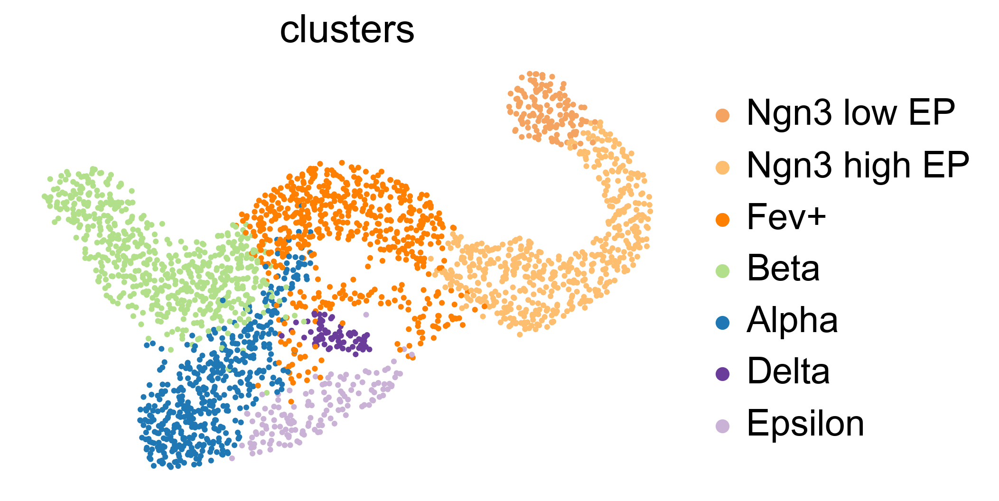

In [10]:
scv.pl.scatter(adata, legend_loc='right', dpi=150)

Print cell type compotision

There are 70 Delta cells in the data


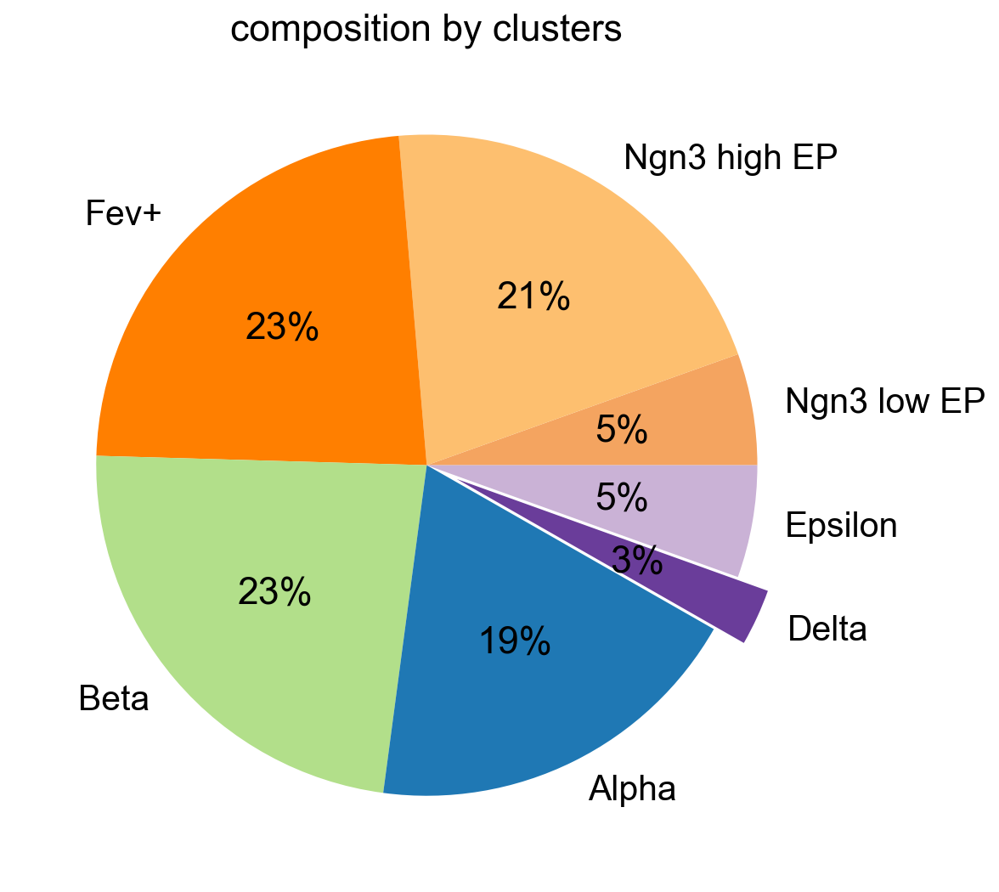

In [11]:
clusters = adata.obs['clusters'].cat.categories
explode = np.zeros(len(clusters))
mask = (clusters == 'Delta')
explode[mask] = 0.1

cr.pl._utils.composition(adata, key='clusters', autopct='%1.0f%%', 
                         explode=explode, figsize=(8, 8))

# print absolute number of Delta cells
print(f"There are {np.sum(adata.obs['clusters'] == 'Delta')} Delta cells in the data")

## Compute Velocities

In [12]:
# filter, normalise, log transform
scv.pp.filter_and_normalize(adata, min_shared_counts=20, log=True, n_top_genes=2000)

# compute pca, knn graph and scvelo's moments
sc.tl.pca(adata)
sc.pp.neighbors(adata, n_pcs=30, n_neighbors=30)
scv.pp.moments(adata, n_pcs=30, n_neighbors=30)

# compute/load from cache the dyn. model params and compute velocities
c.tl.recover_dynamics(adata, fname='recover_dynamics', force=False)
scv.tl.velocity(adata, mode='dynamical')

Filtered out 22024 genes that are detected 20 counts (shared).
Normalized count data: X, spliced, unspliced.
Exctracted 2000 highly variable genes.
Logarithmized X.
computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 30
    finished (0:00:01)
computing moments based on connectivities
    finished (0:00:00) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)
Loading data from: `recover_dynamics.pickle`.
computing velocities
    finished (0:00:02) --> added 
    'velocity', velocity vectors for each individual cell (adata.layers)


Compute moments for the raw anndata object, based on the already computed KNN graph

In [13]:
adata_raw.obsp['connectivities'] = adata.obsp['connectivities'].copy()
adata_raw.obsp['distances'] = adata.obsp['distances'].copy()

scv.pp.moments(adata_raw, n_pcs=30, n_neighbors=30)

computing moments based on connectivities
    finished (0:00:01) --> added 
    'Ms' and 'Mu', moments of un/spliced abundances (adata.layers)


## Project velocities onto the embedding

- compute the velocity graph
- plot velocities in the time-point embedding

Compute the velocity graph

In [14]:
scv.tl.velocity_graph(adata)

computing velocity graph
    finished (0:00:03) --> added 
    'velocity_graph', sparse matrix with cosine correlations (adata.uns)


computing velocity embedding
    finished (0:00:00) --> added
    'velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file /Users/marius/Projects/cellrank_notebooks_dev/figures//pancreas/20082020_ml_fig_2_pancreas/cellrank_fig2_velocities.pdf


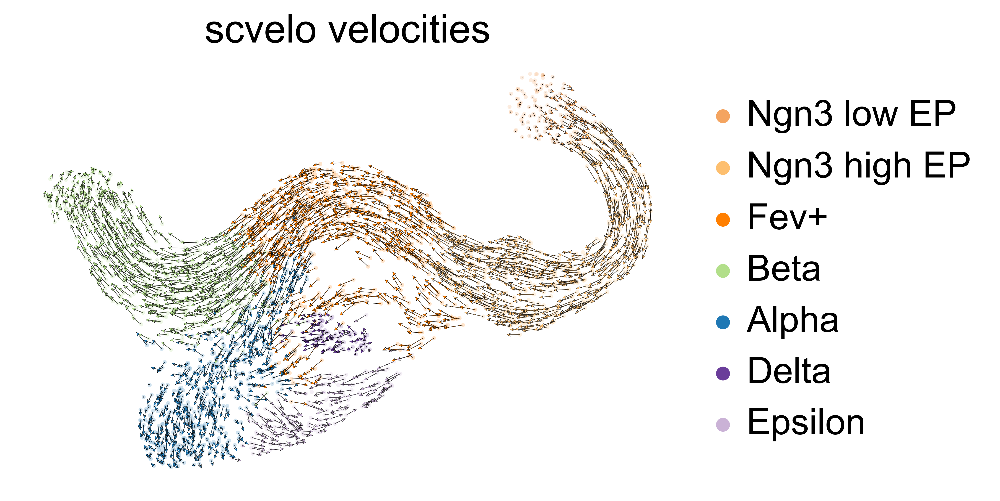

In [15]:
figure_params = {'color': ['clusters'], 'title': f'scvelo velocities',
                 'legend_loc': 'right', 'scale': 0.1, 'dpi': 400}

if save_figure: figure_params['save'] = f'velocities'
scv.pl.velocity_embedding(adata, **figure_params)

## Analyze gene-wise velocities

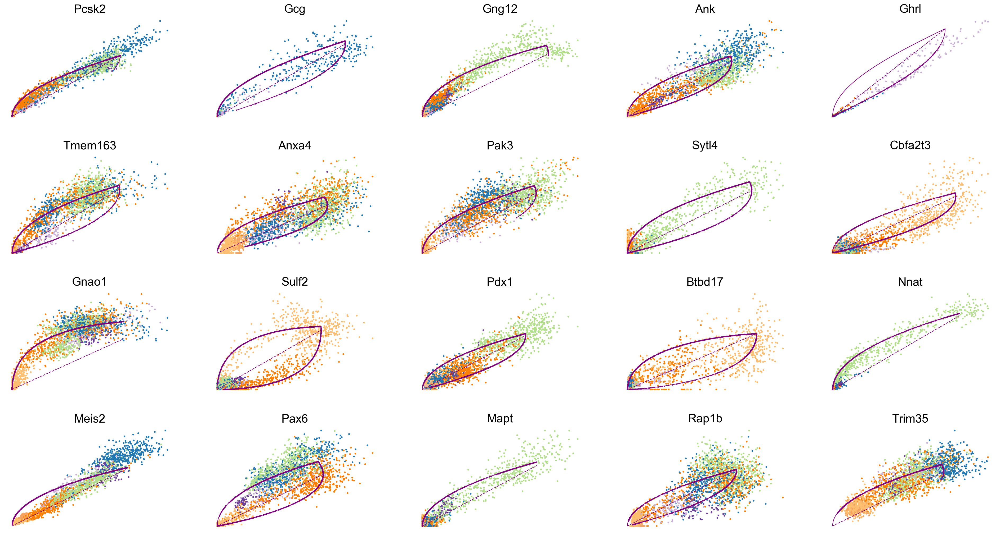

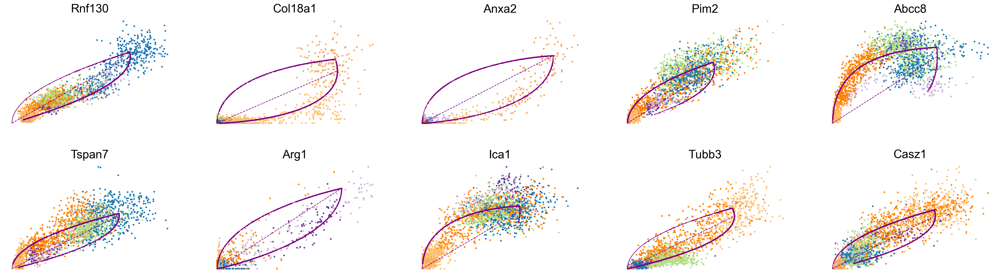

In [16]:
high_likelihood_genes = adata.var.sort_values('fit_likelihood', ascending=False).index
scv.pl.scatter(adata, basis=high_likelihood_genes[:20], frameon=False, ncols=5)
scv.pl.scatter(adata, basis=high_likelihood_genes[20:30], frameon=False, ncols=5)

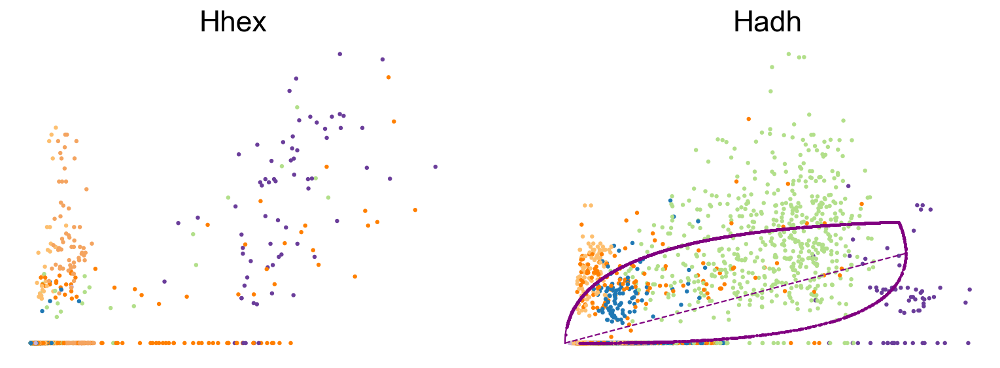

In [17]:
scv.pl.scatter(adata, basis=['Hhex', 'Hadh', 'Cd24a'], frameon=False)

# Run CellRank

## Identify terminal populations

Compute a transition matrix. This is a somewhat convoluted way to cache a computed transition matrix. 

In [18]:
from cellrank.tl.kernels import PrecomputedKernel

c.tl.transition_matrix(adata, weight_connectivities=0.2, mode="stochastic", n_jobs=8, 
                                    softmax_scale=None)

kernel_fwd = PrecomputedKernel(adata.obsp['T_fwd'], adata)

Loading data from: `transition_matrix.pickle`.


What's the softmax scale based on the actual kernel we have used? This should be similar to what the determiniscit model gave us. 

In [19]:
# 1/np.median(np.abs(kernel_fwd.kernels[0].pearson_correlations.data)) 

In [20]:
g_fwd = cr.tl.estimators.GPCCA(kernel_fwd)
print(g_fwd)
dir_key = 'forwards'

GPCCA[n=2531, kernel=<Precomputed[origin='array']>]


In [21]:
# just for consistency, display some summary staes about the transition matrix
T = kernel_fwd.transition_matrix
T_med, T_mean, T_var = np.median(T.data), np.mean(T.data), np.var(T.data)
T_min, T_max = np.min(T.data), np.max(T.data)

print(f'med = {T_med:.6f},\nmean = {T_mean:.6f},\nvar = {T_var:.6f},\nmin = {T_min:.6f},\nmax = {T_max:.6f}')

med = 0.018980,
mean = 0.024591,
var = 0.000451,
min = 0.000067,
max = 0.408042


Computing Schur decomposition
When computing macrostates, choose a number of states NOT in `[6, 9, 13, 15, 17]`
Adding `.eigendecomposition`
       `adata.uns['eig_fwd']`
       `.schur`
       `.schur_matrix`
    Finish (0:00:01)


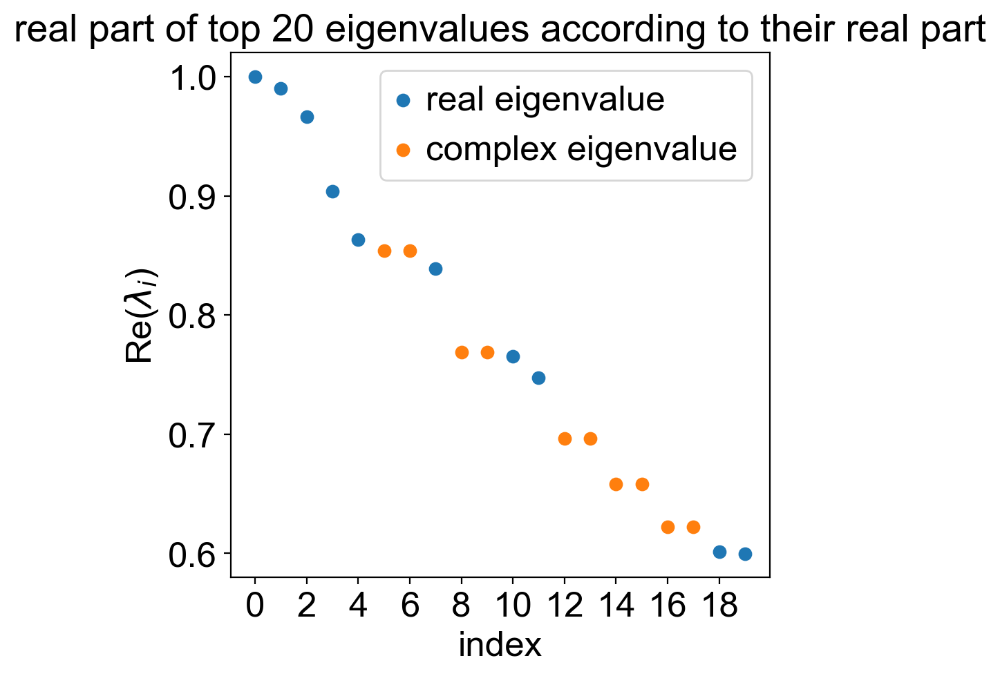

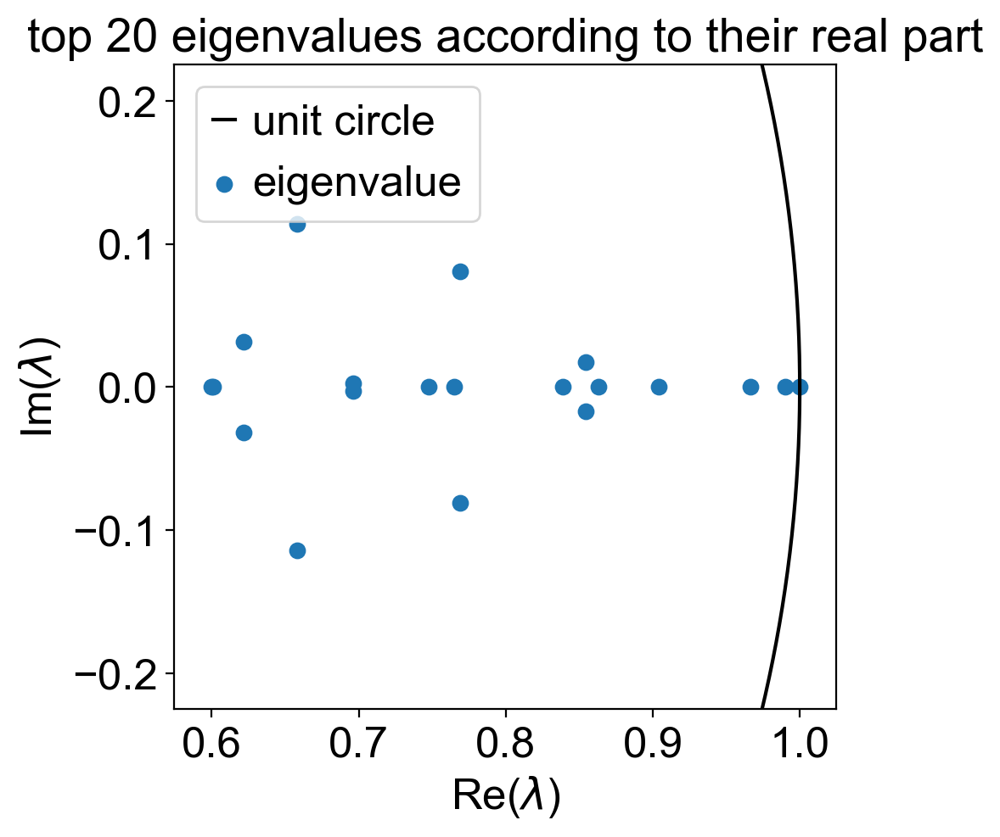

In [22]:
# compute schur decomposition and plot it in the embedding
g_fwd.compute_schur(n_components=20)
g_fwd.plot_spectrum(real_only=True, show_eigengap=False, show_all_xticks=False, s=150)
g_fwd.plot_spectrum(real_only=False, s=150)

Computing `12` macrostates
INFO: Using pre-computed schur decomposition
Adding `.macrostates_memberships`
       `.macrostates`
       `.schur`
       `.coarse_T`
       `.coarse_stationary_distribution`
    Finish (0:00:06)


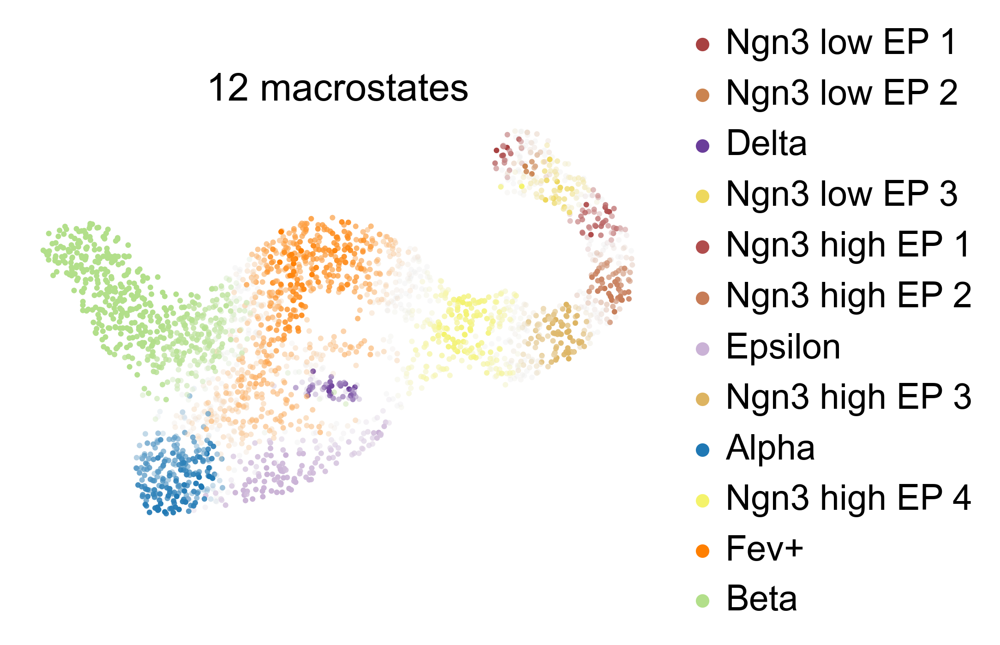

In [23]:
n_states = 12

g_fwd.compute_macrostates(cluster_key='clusters', n_states=n_states)
g_fwd.plot_macrostates(legend_loc='right', discrete = False, title=f'{n_states} macrostates', dpi=150)

Plot the corresponding coarse-grained transition matrix. 

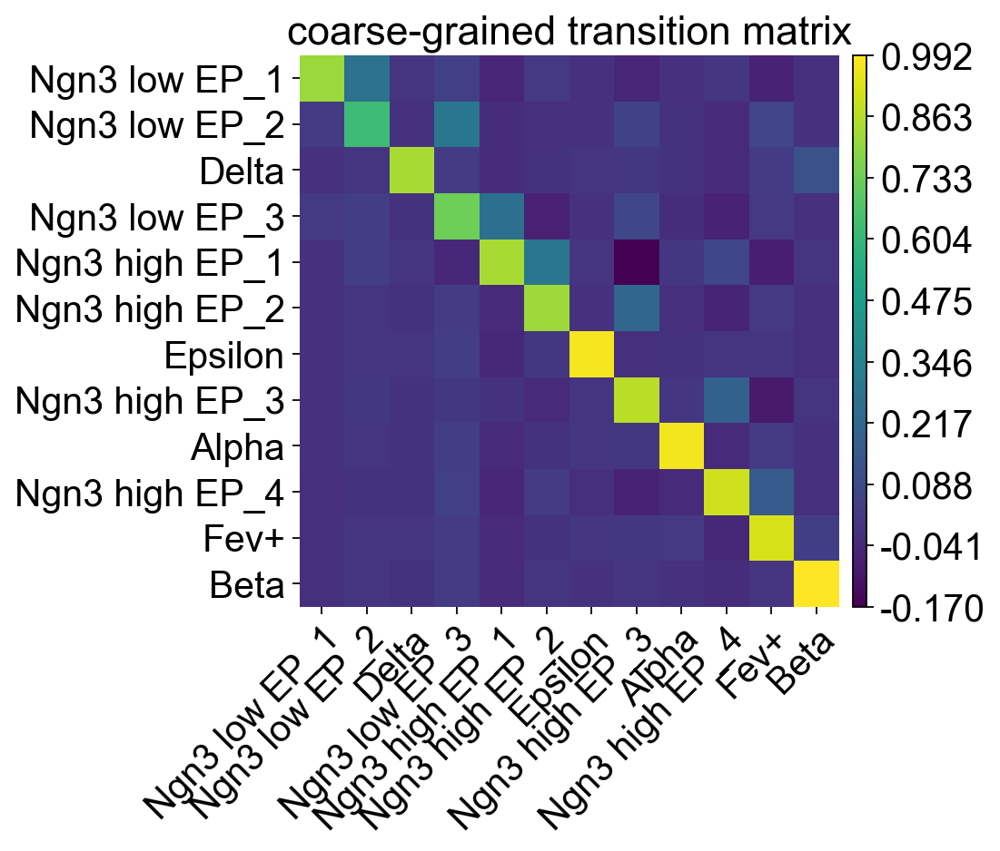

In [24]:
g_fwd.plot_coarse_T(annotate=False, figsize=(5, 5), cmap='viridis', show_stationary_dist=False)

Based on this matrix, identify the terminal states:

In [25]:
g_fwd.set_terminal_states_from_macrostates(names=['Alpha', 'Beta', 'Epsilon', 'Delta'])

Adding `adata.obs['terminal_states_probs']`
       `adata.obs['terminal_states']`
       `adata.obsm['macrostates_fwd']`
       `.terminal_states_probabilities`
       `.terminal_states`


## Determine initial states

In [26]:
g_fwd._set_initial_states_from_macrostates(names=['Ngn3 low EP_1'])

Adding `adata.obs['initial_states_probs']`
       `adata.obs['initial_states']`



In [27]:
# initial_state = 'Ngn3 low EP_1'

# # create obs annotation
# mask = g_fwd.metastable_states == initial_state
# adata.obs['initial_states'] = pd.Series()
# adata.obs.loc[mask, 'initial_states'] = initial_state
# adata.obs['initial_states'] = adata.obs['initial_states'].astype('category')

# # copy the color
# adata.uns['initial_states_colors'] = g_fwd._metastable_states_memberships['Ngn3 low EP_1'].colors

# # create the continous `initial_states_probs` annotation
# initial_states_probs = g_fwd._metastable_states_memberships['Ngn3 low EP_1'].X
# adata.obs['initial_states_probs'] = initial_states_probs/np.max(initial_states_probs)

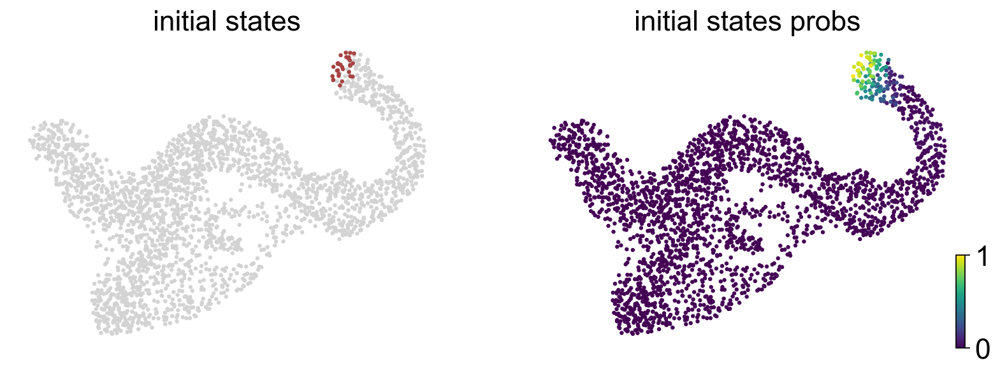

In [28]:
scv.pl.scatter(adata, c=['initial_states', 'initial_states_probs'], color_map='viridis')

## Plot transition matrix by metastable states

We want a visualisation of the transition matrix, potentially of the sparsity pattern, where states are sorted according to their membership to macrostates. 

In [26]:
# get the transition matrix
T = kernel_fwd.transition_matrix.A

# sort the cells by macrostate membership
meta_states_probs = g_fwd.metastable_states_memberships
cell_assignment = meta_states_probs.argmax(1).X.flatten()
p = np.argsort(cell_assignment)
print(meta_states_probs.names)

['Ngn3 low EP_1' 'Ngn3 low EP_2' 'Delta' 'Ngn3 low EP_3' 'Ngn3 high EP_1'
 'Ngn3 high EP_2' 'Epsilon' 'Ngn3 high EP_3' 'Alpha' 'Ngn3 high EP_4'
 'Fev+' 'Beta']


Look at the distribution of non-zero values

<AxesSubplot:>

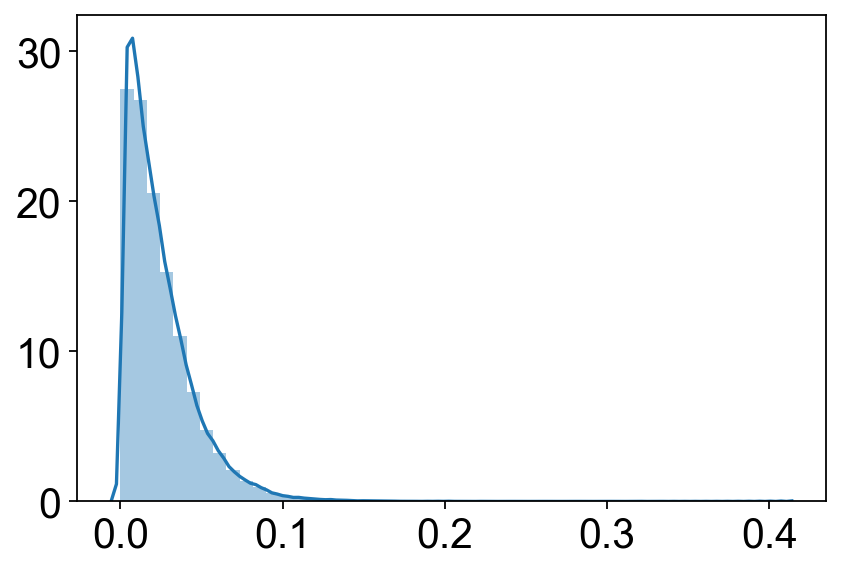

In [27]:
distplot(T[T>0])

Plot the actual transition matrix

In [28]:
# takes ~ 5 min

# vmax = np.quantile(T[T>0], 0.90)

# fig = plt.figure(None, dpi=400)
# ax = fig.add_subplot(111)

# cax = ax.imshow(T[p ,:][:, p], vmin=0, vmax=vmax, cmap='Reds', interpolation='sinc', filterrad=40.0)

# ax.set_xticks([])
# ax.set_yticks([])
# ax.set_title('transition matrix')

# plt.colorbar(mappable=cax)
# plt.savefig(f"{figdir}/transition_matrix_by_metastate_values.pdf", bbox_inches='tight')
# plt.show()

Same for the unsorted matrix to compare

In [29]:
# takes ~5 min

# vmax = np.quantile(T[T>0], 0.90)

# fig = plt.figure(None, dpi=400)
# ax = fig.add_subplot(111)
# cax = ax.imshow(T, vmin=0, vmax=vmax, cmap='Reds', interpolation='sinc', filterrad=40.0)

# ax.set_xticks([])
# ax.set_yticks([])
# ax.set_title('transition matrix')

# plt.colorbar(mappable=cax)
# plt.savefig(f"{figdir}/transition_matrix_by_metastate_values_unsorted.pdf", bbox_inches='tight')
# plt.show()

Plot the sparsity pattern in the transition matrix

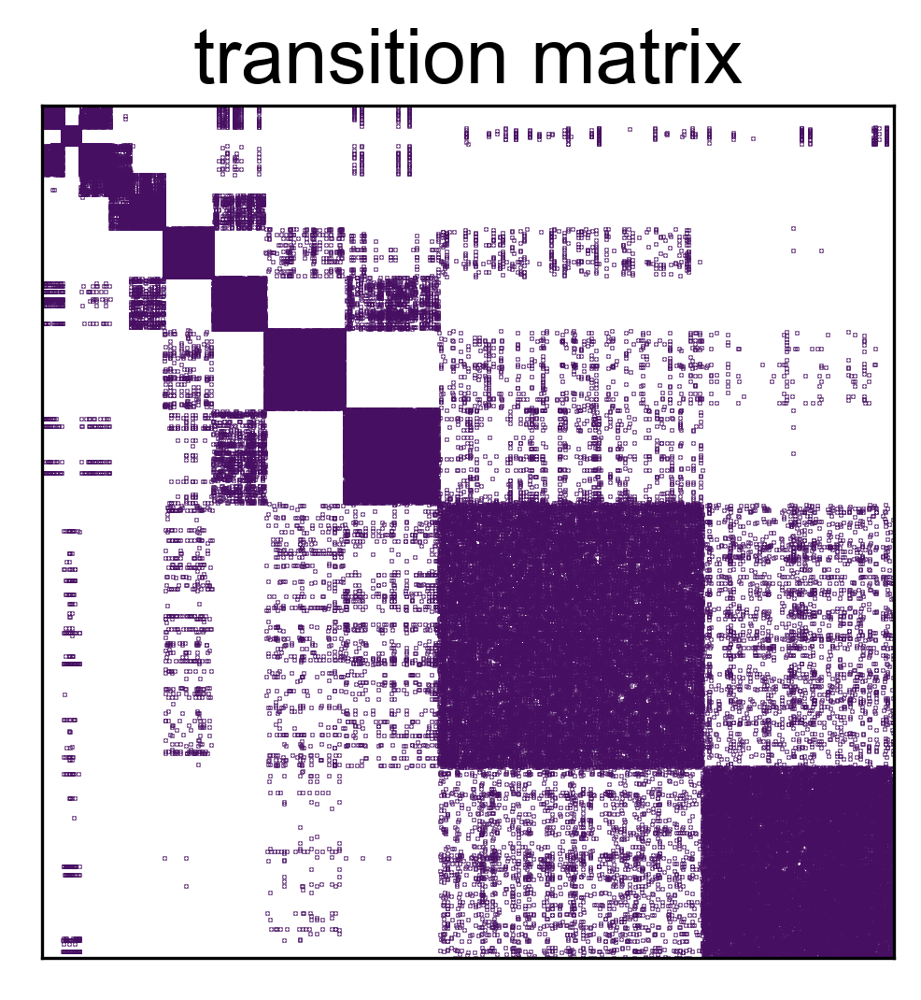

In [30]:
fig = plt.figure(None, dpi=150)
ax = fig.add_subplot(111)
ax.spy(T[p ,:][:, p], precision=0, markersize=0.05, c="#470F62")

ax.set_xticks([])
ax.set_yticks([])
ax.set_title('transition matrix')
plt.savefig(f"{figdir}/transition_matrix_by_metastate.pdf", bbox_inches='tight')
plt.show()

As a comparison, plot with no sorting of sates

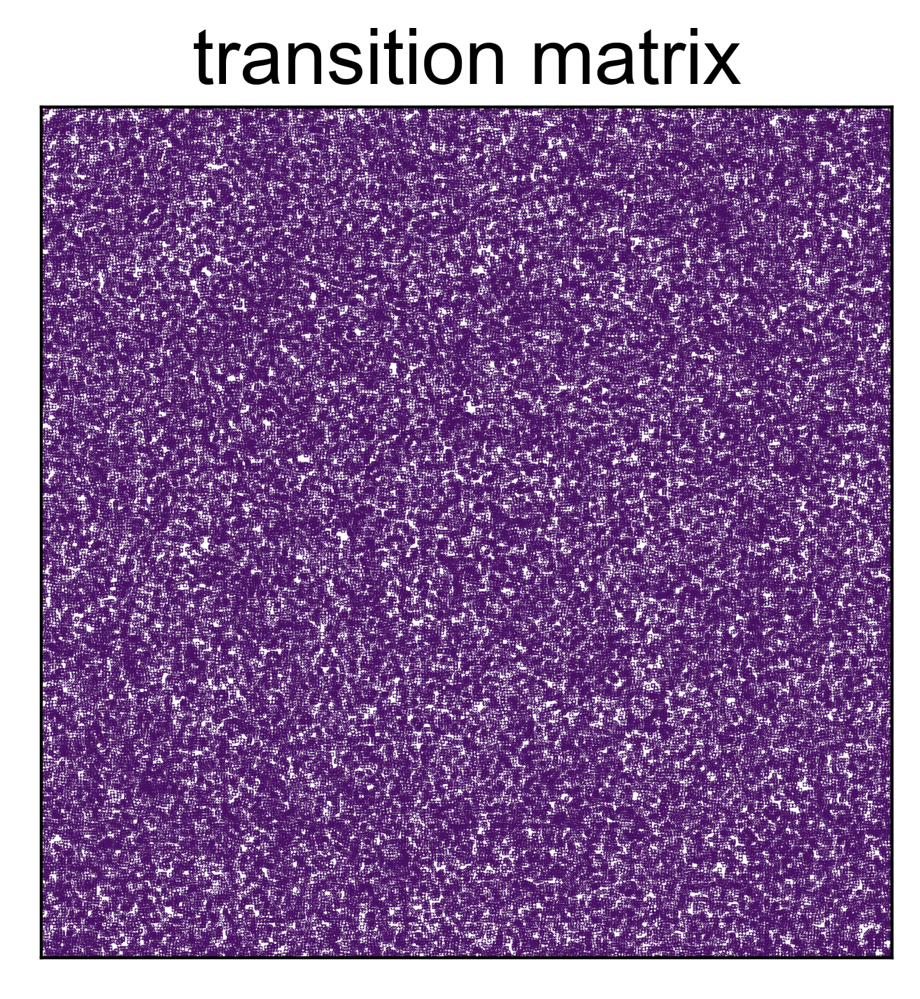

In [31]:
fig = plt.figure(None, dpi=200)
ax = fig.add_subplot(111)
ax.spy(T, precision=0, markersize=0.05, c="#470F62")

ax.set_xticks([])
ax.set_yticks([])
ax.set_title('transition matrix')
plt.savefig(f"{figdir}/transition_matrix_unsorted.pdf", bbox_inches='tight')
plt.show()

## Aggregate initial and terminal populations

In [32]:
from cellrank.tl._utils import _create_initial_terminal_annotations

saving figure to file /Users/marius/Projects/cellrank_notebooks_dev/figures//pancreas/20082020_ml_fig_2_pancreas/cellrank_fig2_root_final.pdf


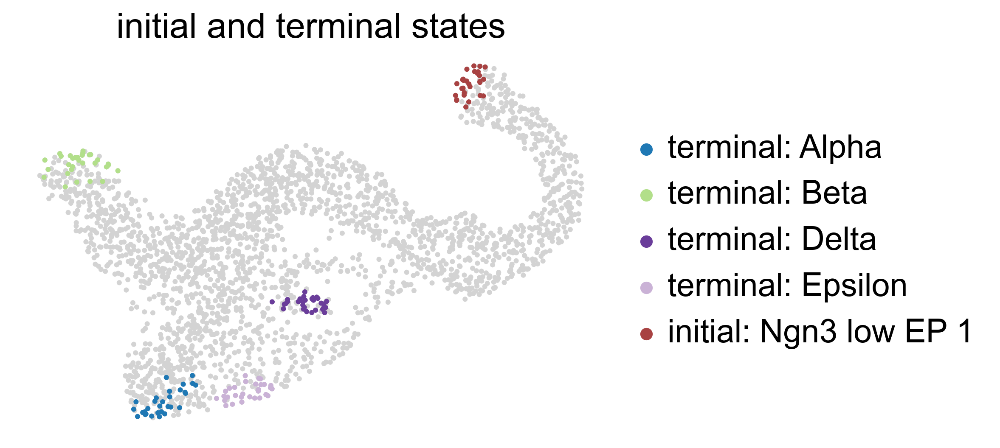

In [33]:
_create_initial_terminal_annotations(adata)

figure_params = {'title': f'initial and terminal states', 'legend_loc': 'right', 'dpi': 150}
if save_figure: figure_params['save'] = f'initial_terminal.pdf'
scv.pl.scatter(adata, color='initial_terminal', **figure_params)

## Compute and plot absorption probabilities

In [34]:
g_fwd.compute_absorption_probabilities()

Computing absorption probabilities
Adding `adata.obsm['to_terminal_states']`
       `adata.obs['to_terminal_states_dp']`
       `.absorption_probabilities`
       `.diff_potential`
    Finish (0:00:00)


saving figure to file /Users/marius/Projects/cellrank_notebooks_dev/figures//pancreas/20082020_ml_fig_2_pancreas/cellrank_fig2_final_states_grad.pdf


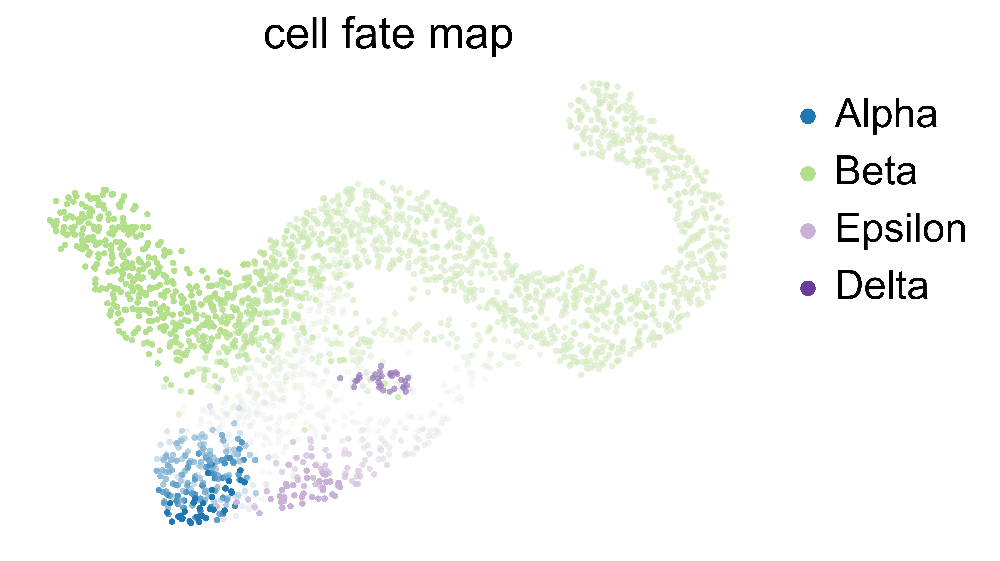

In [35]:
figure_kwargs = {'title': f'cell fate map', 'dpi': 400}
if save_figure: figure_kwargs['save'] = f'terminal_states_grad'
g_fwd.plot_absorption_probabilities(same_plot=True, **figure_kwargs)

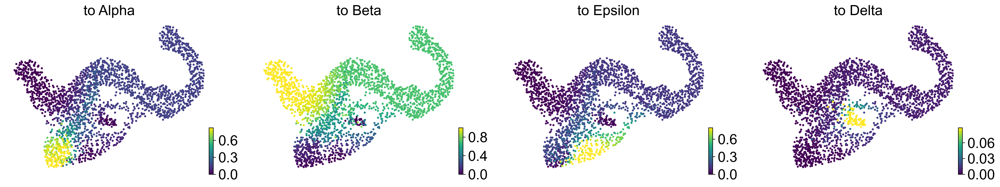

In [36]:
g_fwd.plot_absorption_probabilities(same_plot=False, perc=[0, 97], dpi=150, show_dp=False)

## Prepare for gene trend plotting

For plotting, use the raw anndata object. Copy over the lineage probabilities. 

In [37]:
adata_raw.obsm['to_terminal_states'] = adata.obsm['to_terminal_states'].copy()
adata_raw.uns['terminal_states_colors'] = adata.uns['terminal_states_colors'].copy()
adata_raw.uns['to_terminal_states_colors'] = adata.uns['to_terminal_states_colors'].copy()

Check the initial and terminal state identification wich will be used to initialise latent time. 

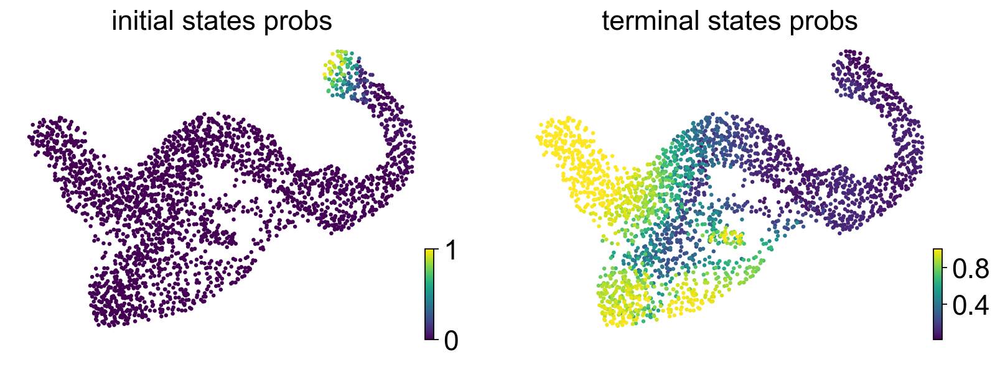

In [38]:
scv.pl.scatter(adata, color=['initial_states_probs', 'terminal_states_probs'], color_map='viridis')

Compute latent time

computing latent time using initial_states_probs, terminal_states_probs as prior
    finished (0:00:00) --> added 
    'latent_time', shared time (adata.obs)


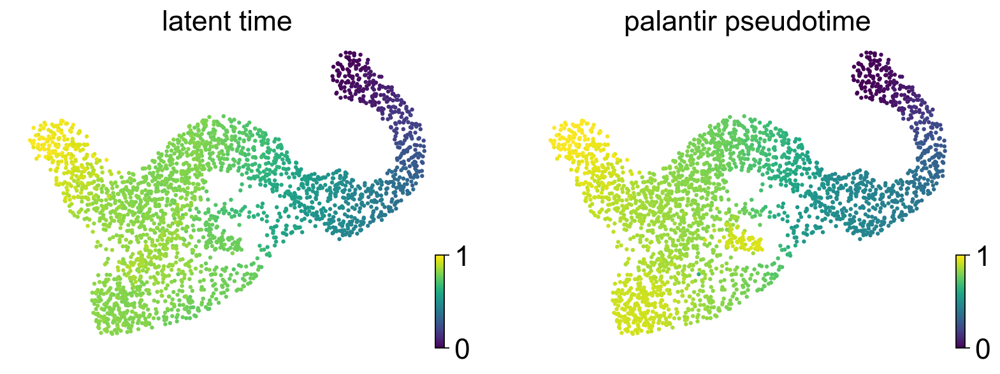

In [39]:
scv.tl.recover_latent_time(adata, root_key='initial_states_probs', end_key='terminal_states_probs')

# copy latent time over into the raw anndata object
adata_raw.obs['latent_time'] = adata.obs['latent_time'].copy()

scv.pl.scatter(adata_raw, color=['latent_time', 'palantir_pseudotime'], color_map='viridis')

## Plot trends for Fig. 2

Plot for the pancres figure

Computing trends using `1` core(s)



    Finish (0:00:00)
Plotting trends


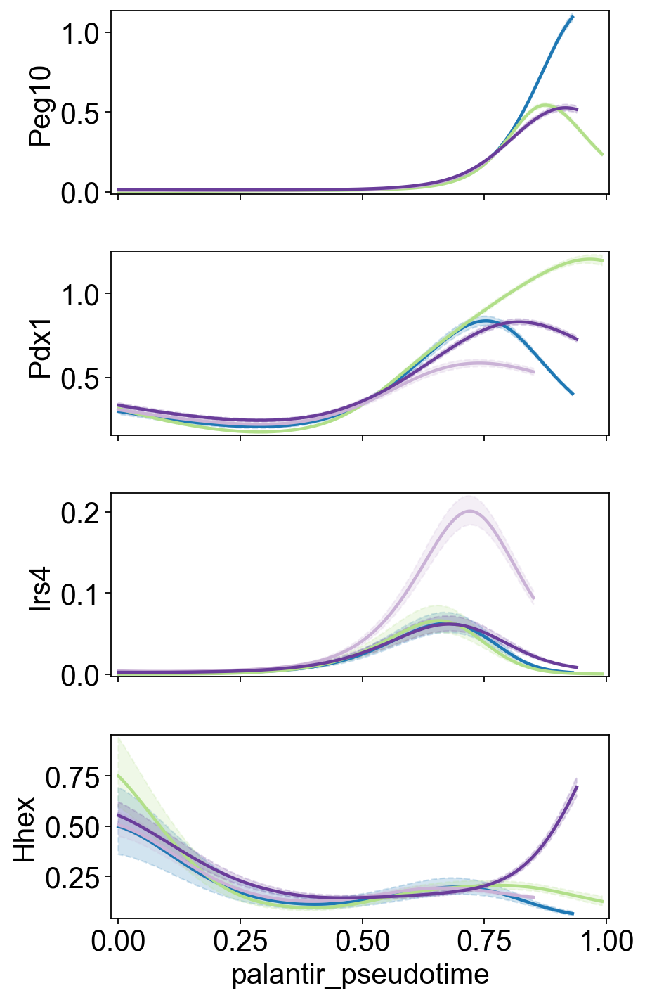

In [72]:
fig_2_genes = ['Peg10', 'Pdx1', 'Irs4', 'Hhex']

model = cr.ul.models.GAM(adata_raw, n_splines=10, spline_kwargs={'lam': 5})  
cr.pl.gene_trends(adata_raw, model=model, data_key='magic_imputed_data', gene_as_title=False, legend_loc=None,
                  genes=fig_2_genes, ncols=1,
                  time_key='palantir_pseudotime', same_plot=True, hide_cells=True,
                  weight_threshold=(0.1, 0.1), figsize=(6, 9), suptitle="")

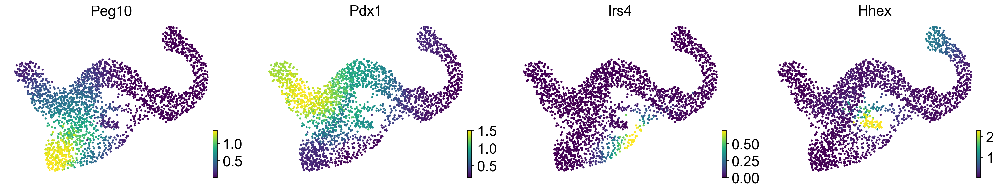

In [73]:
scv.pl.scatter(adata_raw, c=fig_2_genes, perc=[0, 99], layer='magic_imputed_data', title=fig_2_genes)

## Plot trends for Fig. 5 (benchmarks)

Plot Hhex separetely for the benchmarking figure. 

Computing trends using `1` core(s)



    Finish (0:00:00)
Plotting trends


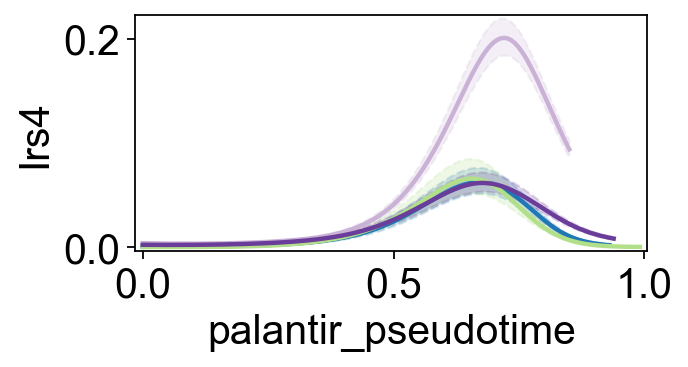

In [42]:
model = cr.ul.models.GAM(adata_raw, n_splines=10, spline_kwargs={'lam': 5})  
cr.pl.gene_trends(adata_raw, model=model, data_key='magic_imputed_data', gene_as_title=False, legend_loc=None,
                  genes=['Irs4'], ncols=1, figsize=(4.5, 2.5),
                  time_key='palantir_pseudotime', same_plot=True, hide_cells=True,
                  weight_threshold=(0.1, 0.1), suptitle="")

Show expression in the UMAP

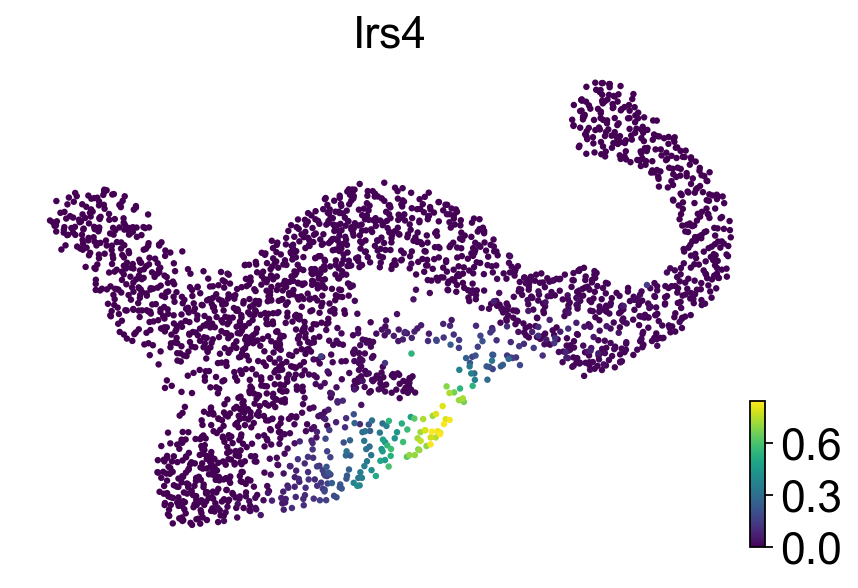

In [43]:
name = 'Irs4'
scv.pl.scatter(adata_raw, color=name, layer='magic_imputed_data', title=name)

More genes

Computing trends using `1` core(s)



    Finish (0:00:01)
Plotting trends


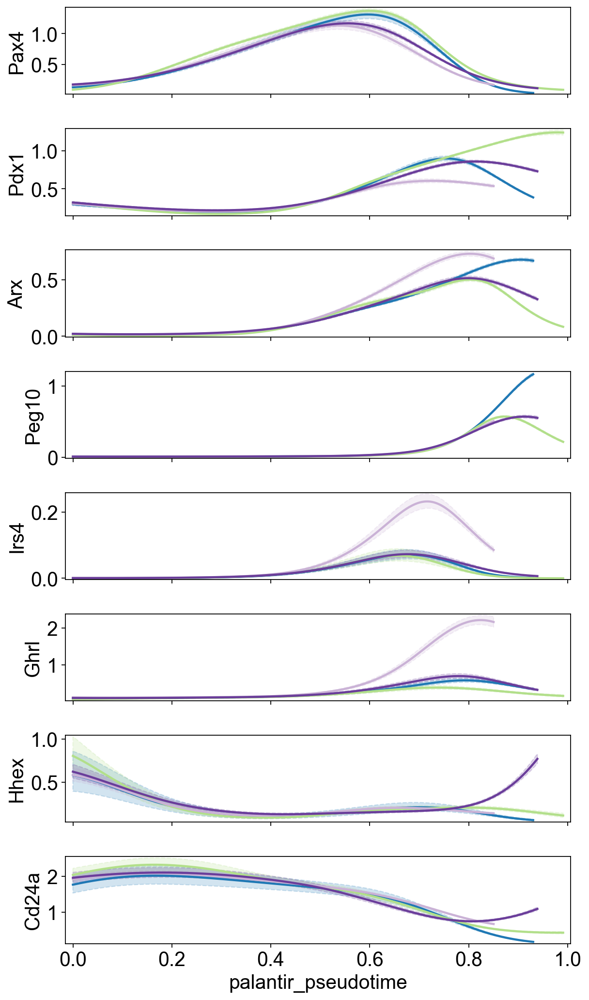

In [44]:
# two from each lineage in the order Beta, Alpha, Epsilon, Delta
test_genes = ['Pax4', 'Pdx1', 'Arx', 'Peg10', 'Irs4', 'Ghrl', 'Hhex', 'Cd24a']

model = cr.ul.models.GAM(adata_raw, n_splines=10)  
cr.pl.gene_trends(adata_raw, model=model, data_key='magic_imputed_data', gene_as_title=False, legend_loc=None,
                  genes=test_genes, ncols=1,
                  time_key='palantir_pseudotime', same_plot=True, hide_cells=True,
                  weight_threshold=(0.1, 0.1), suptitle="", figsize=(8, 13))

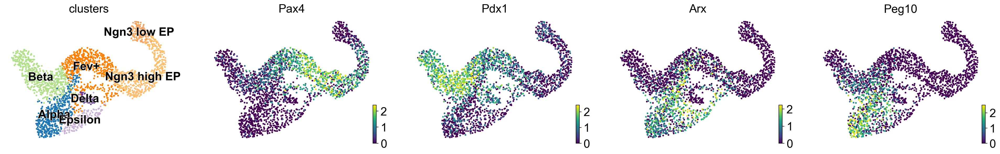

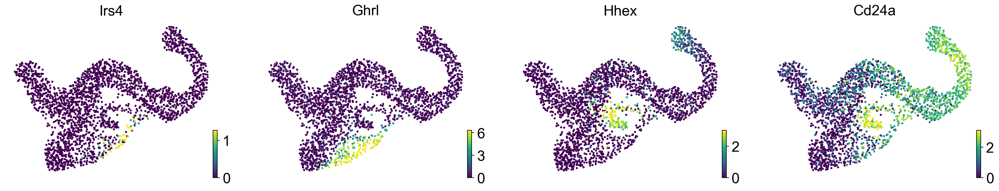

In [45]:
scv.pl.scatter(adata_raw, c=['clusters'] + test_genes[:4], 
              perc=[0, 99], legend_loc='on data')

scv.pl.scatter(adata_raw, c=test_genes[4:], 
              perc=[0, 99], legend_loc='on data')

## Delta lineage - Fig. 3

Show expression of Sst, the hormone produced by Delta cells

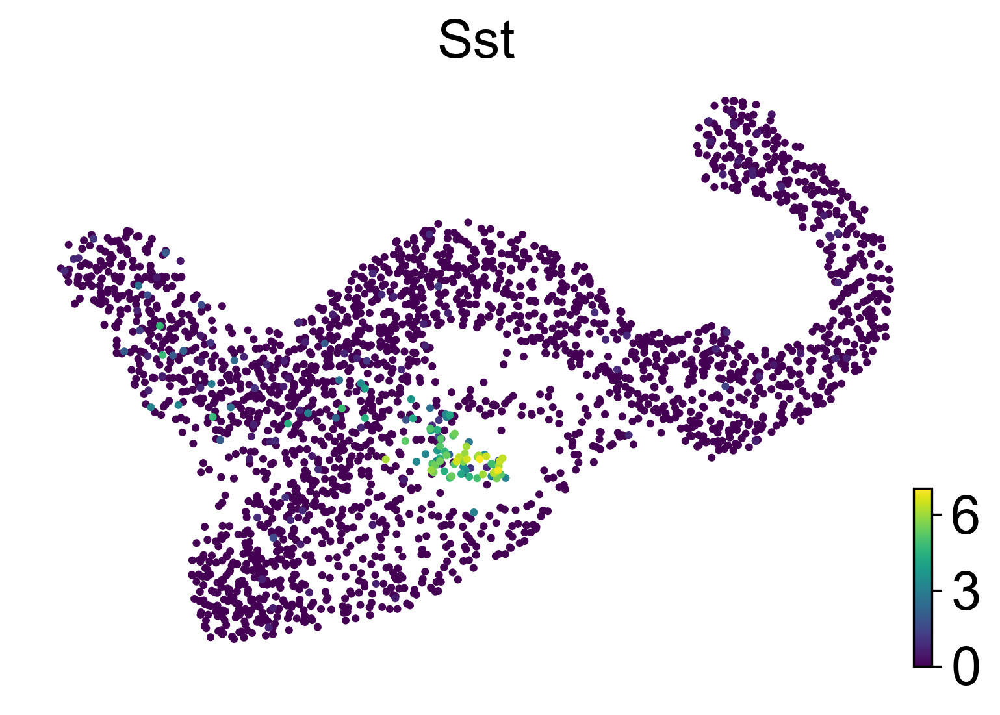

In [46]:
scv.pl.scatter(adata, c='Sst', dpi=150)

Compute lineage drivers towards the Delta lineage

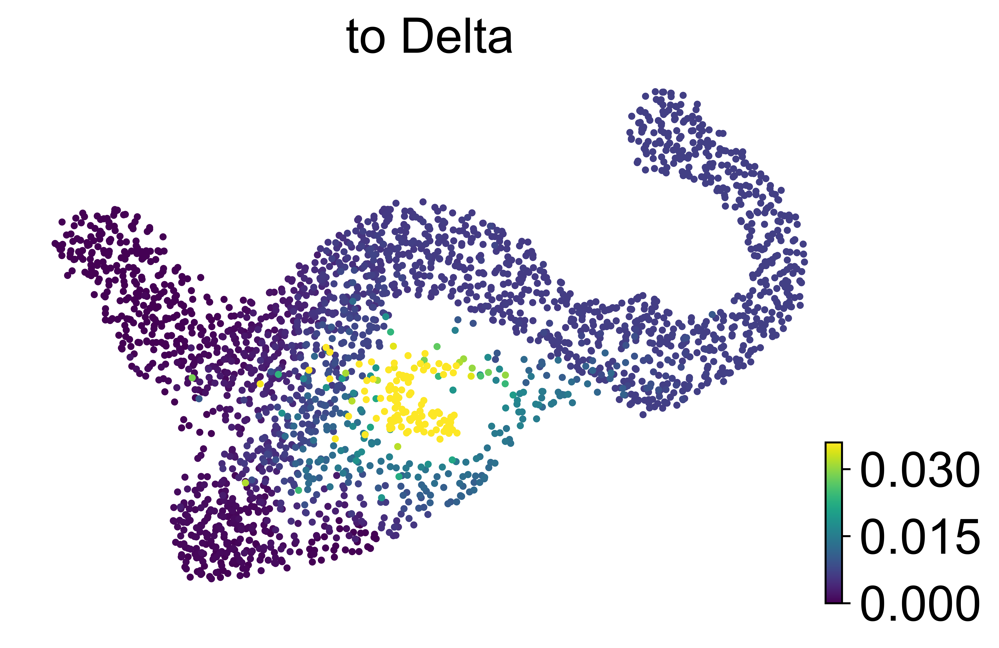

In [47]:
g_fwd.plot_absorption_probabilities(same_plot=False, perc=[0, 96], dpi=600, lineages=['Delta'], 
                                    show_dp=False)

Quantify bias towards Delta by averaging

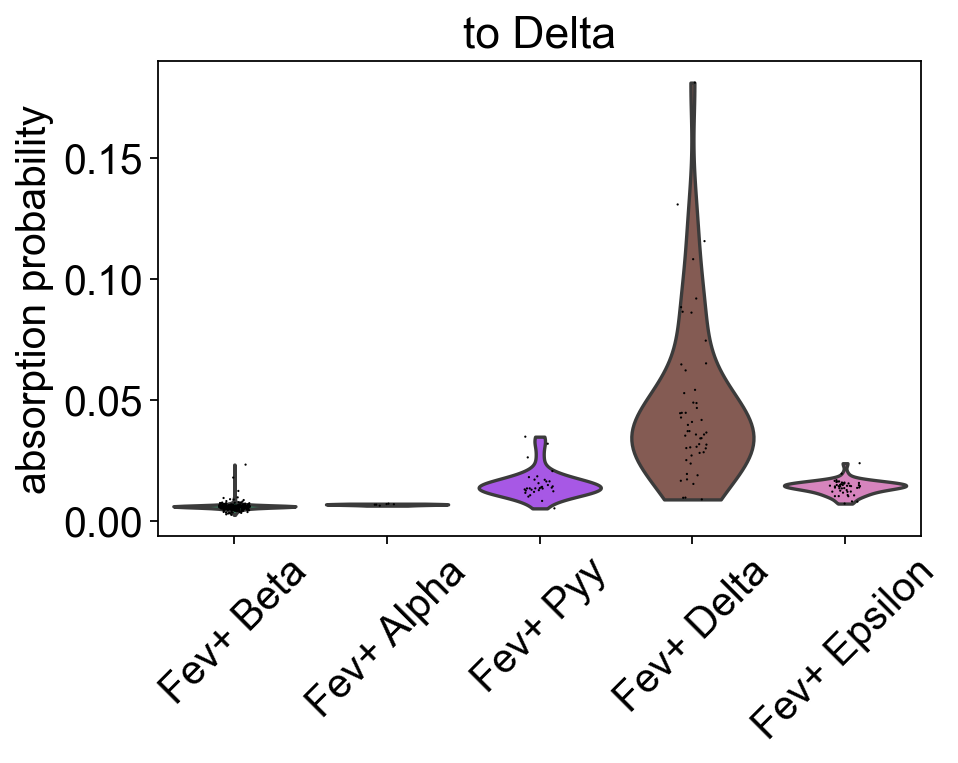

In [48]:
cr.pl.cluster_fates(adata, mode='violin', lineages='Delta', cluster_key='clusters_fine',
                   clusters=['Fev+ Beta', 'Fev+ Alpha', 'Fev+ Delta', 'Fev+ Epsilon', 'Fev+ Pyy'],
                   )

In [49]:
g_fwd.compute_lineage_drivers(lineages=['Delta'], cluster_key='clusters', clusters=['Fev+'], use_raw=True)
delta_corr = adata.raw.var.sort_values(by='to Delta', ascending=False)

# filter the results to contain only highly variable genes
delta_corr = delta_corr.head(50)
delta_corr = delta_corr[delta_corr['highly_variable_genes'] == "True"]
delta_corr = delta_corr[delta_corr['n_cells'] > 10]
print(f"Selected {len(delta_corr)} genes")

Computing correlations for lineages `['Delta']` restricted to clusters `['Fev+']` in layer `X` with `use_raw=True`
Adding `.lineage_drivers`
       `adata.raw.var['to Delta']`
    Finish (0:00:00)
Selected 32 genes


Plot the gene expression trends as a heatmap

Computing trends using `1` core(s)


did not converge

    Finish (0:00:05)


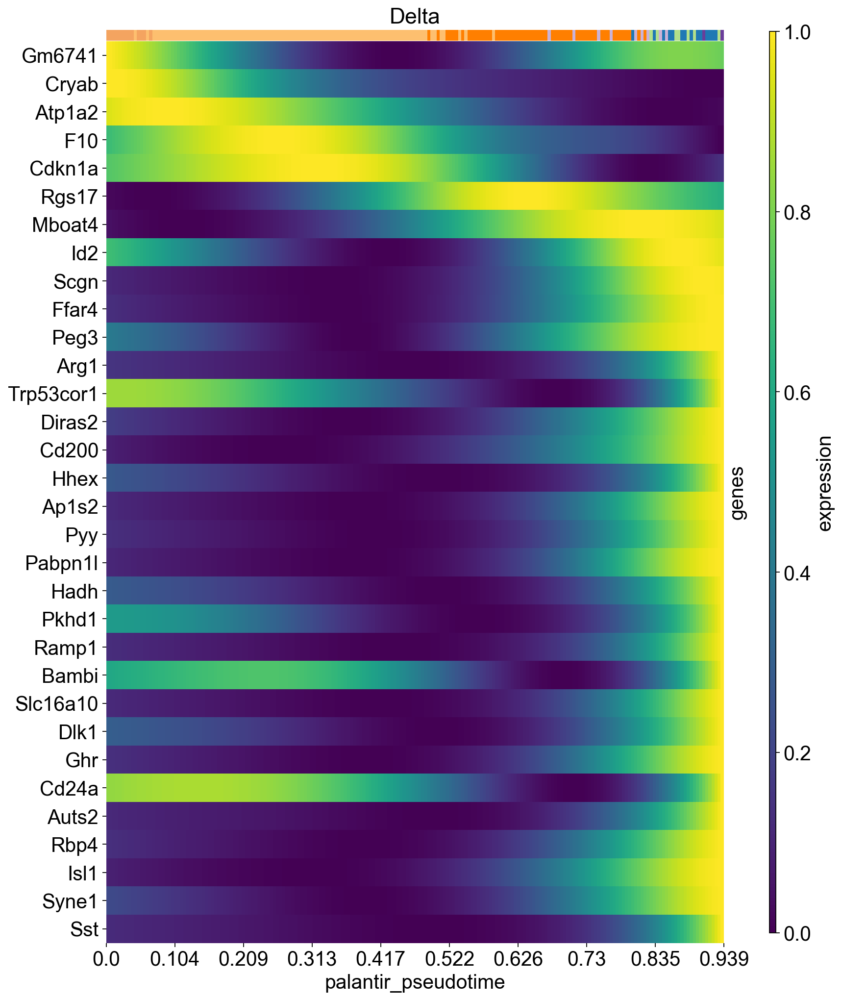

In [50]:
model = cr.ul.models.GAM(adata_raw, n_splines=10)
cr.pl.heatmap(adata_raw, model, genes=delta_corr.head(50).index, lineages=['Delta'], cluster_key='clusters', 
              data_key='magic_imputed_data', time_key='palantir_pseudotime',
              show_absorption_probabilities=False, figsize=(12, 15), show_all_genes=True) 

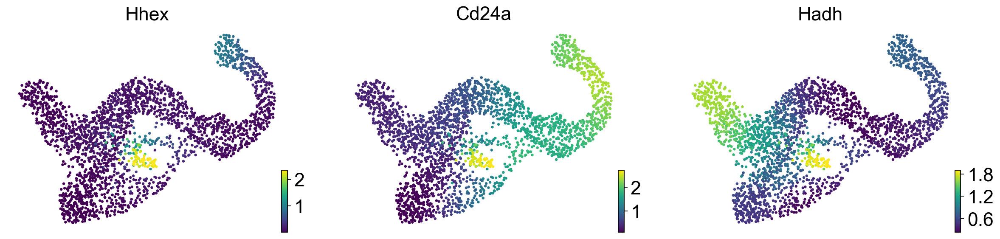

In [51]:
names = ['Hhex', 'Cd24a', 'Hadh']
scv.pl.scatter(adata_raw, color=names, layer='magic_imputed_data', title=names)

Next, we want to cluster gene expression trends along the Delta lineage. We do need to make some sort of pre-selection on the genes. 

Computing gene trends using `8` core(s)



    Finish (0:06:04)
computing PCA
    with n_comps=49
    finished (0:00:00)
computing neighbors
    using 'X_pca' with n_pcs = 49
    finished (0:00:06)
running Louvain clustering
    using the "louvain" package of Traag (2017)
    finished (0:00:00)
Saving data to `adata.uns['lineage_Delta_trend']`


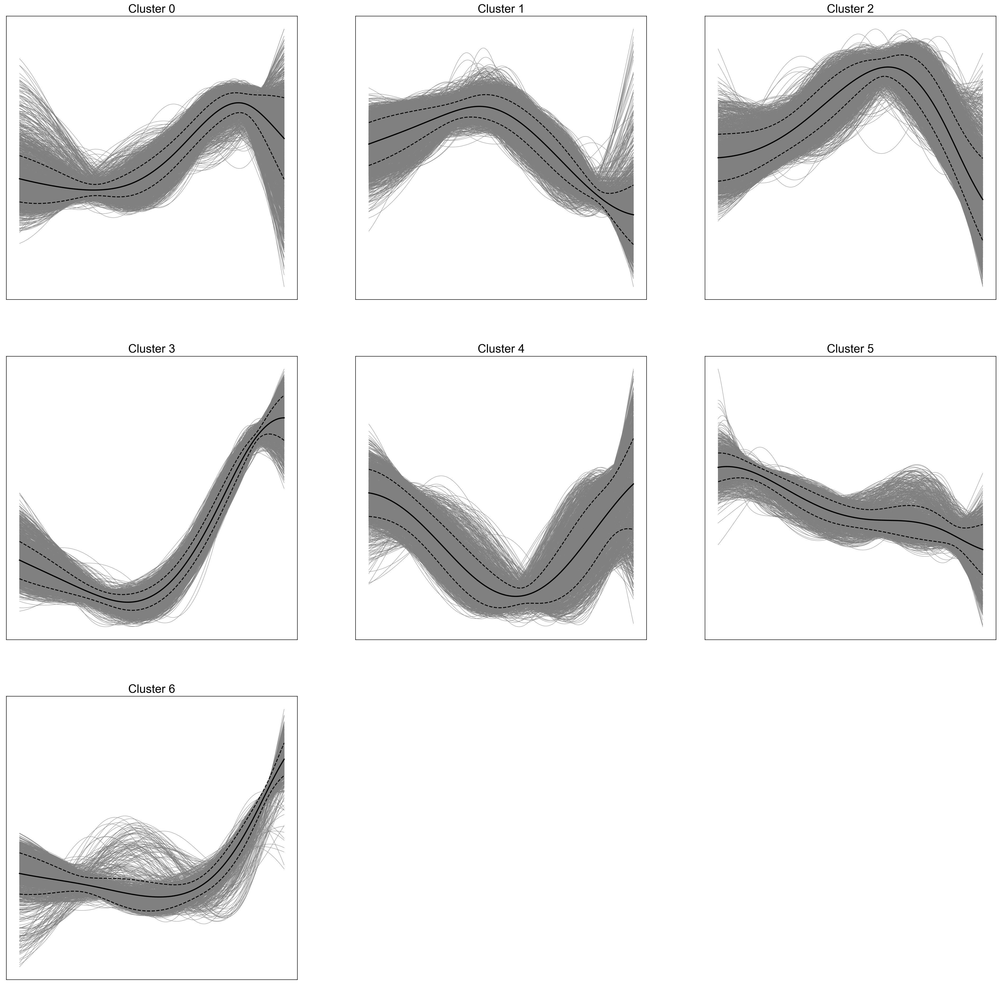

In [52]:
model = cr.ul.models.GAM(adata_raw, n_splines=10)
cr.pl.cluster_lineage(
    adata_raw,
    model, 
    adata_raw.var_names,
    lineage="Delta",
    time_key="palantir_pseudotime", n_jobs=8, data_key='magic_imputed_data', recompute=True, random_state=0,
    clustering_kwargs={'resolution': 0.2, 'random_state': 0}, neighbors_kwargs={'random_state': 0}
)

The results are saved in an AnnData object, which is actually stored within the current AnnData object!

In [53]:
gdata = adata_raw.uns['lineage_Delta_trend'].copy()

Select genes from a particular cluster

In [54]:
gene_clusters = ['2']

mask = np.in1d(gdata.obs['clusters'], gene_clusters)
gene_df = gdata[mask].obs

Let's rank these genes according to their correlation with Delta fate probs

In [55]:
# re-compute linege drivers, using also the earlier clusters
g_fwd.compute_lineage_drivers(lineages=['Delta'], cluster_key='clusters', 
                              clusters=['Fev+', 'Ngn3 low EP', 'Ngn3 high EP'], use_raw=True)

gene_df = gene_df.join(adata.raw.var)
gene_df = gene_df.sort_values(by='to Delta', ascending=False)
gene_df.head(10)

Computing correlations for lineages `['Delta']` restricted to clusters `['Fev+', 'Ngn3 low EP', 'Ngn3 high EP']` in layer `X` with `use_raw=True`
Adding `.lineage_drivers`
       `adata.raw.var['to Delta']`
    Finish (0:00:00)


,clusters,highly_variable_genes,n_cells,gene_count_corr,highly_variable,means,dispersions,dispersions_norm,to Delta
Rgs17,2,True,1421,-0.1916,True,0.829772,1.030725,2.199433,0.260733
Tmem184c,2,True,567,-0.0185,True,0.248889,0.332961,1.025965,0.161083
Kcnh1,2,False,20,-0.0055,False,0.008116,0.097048,0.216763,0.147799
Ophn1,2,True,136,-0.0061,False,0.052518,0.042445,-0.102418,0.133901
Gm30074,2,False,30,-0.0043,False,0.011440,0.024653,-0.206424,0.133134
Cacna2d1,2,True,885,-0.1250,True,0.410424,0.357502,1.146303,0.130849
Map2k4,2,False,405,-0.0095,False,0.158691,0.019142,-0.238639,0.118400
Dcun1d4,2,False,84,0.0366,False,0.030325,-0.055554,-0.675269,0.118307
Casp9,2,False,66,-0.0102,False,0.025015,-0.013951,-0.432082,0.115506
Lpcat3,2,False,1070,-0.1012,False,0.471291,0.224780,0.203254,0.115238


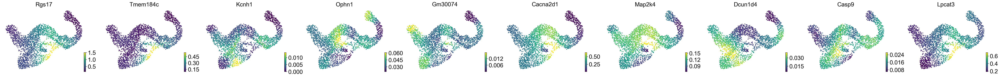

In [56]:
names = list(gene_df.index[:10])
scv.pl.scatter(adata_raw, c=names, layer='magic_imputed_data', title=names,
               perc=[0, 99])

Grab a subset of these genes

[ 6 13 39]


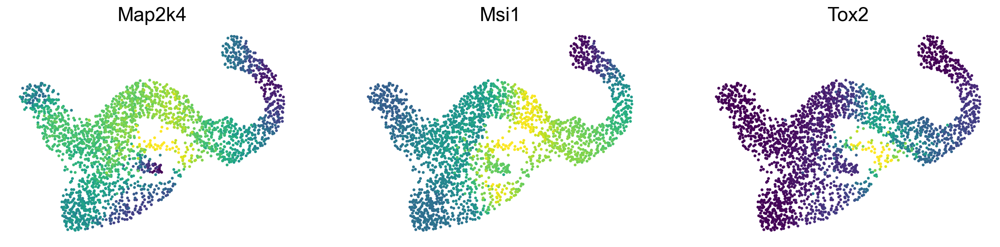

In [57]:
names = ['Map2k4', 'Msi1', 'Tox2']
# names = [ 'Emb', 'Trnp1', 'Pitpna']

# where are these in the long dataframe? [6, 13, 39]
print(np.where(np.in1d(gene_df.index, names))[0])

# plot these genes
scv.pl.scatter(adata_raw, c=names, layer='magic_imputed_data', title=names,
               perc=[0, 99], colorbar=False)

## Aggregate to cluster level using directed PAGA

In [58]:
if 'paga' in adata.uns.keys():
    del adata.uns['paga']
scv.tl.paga(adata, groups='clusters', root_key='initial_states_probs', end_key='terminal_states_probs', 
            use_time_prior='velocity_pseudotime')

running PAGA using priors: ['velocity_pseudotime', 'initial_states_probs', 'terminal_states_probs']
    finished (0:00:00) --> added
    'paga/connectivities', connectivities adjacency (adata.uns)
    'paga/connectivities_tree', connectivities subtree (adata.uns)
    'paga/transitions_confidence', velocity transitions (adata.uns)


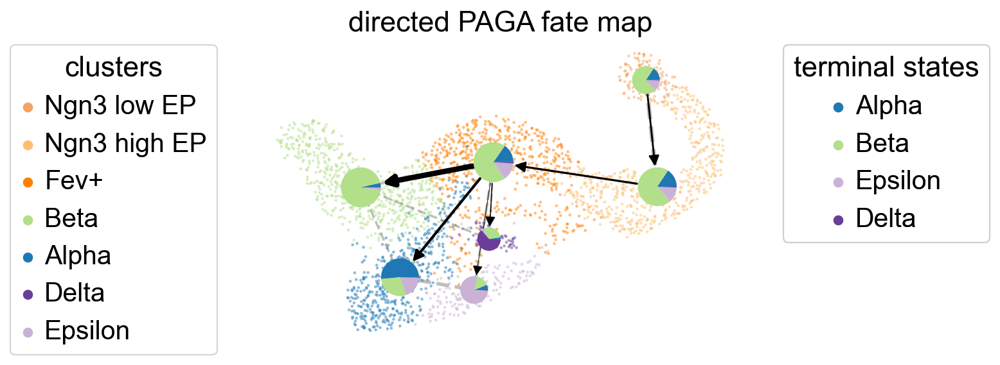

In [59]:
figure_kwargs = {'cluster_key': 'clusters', 'mode':'paga_pie', 'basis':'umap',
                'legend_kwargs':{'loc':'top right out'}, 'legend_loc':'top left out', 'node_size_scale':5, 
                'edge_width_scale':1, 'max_edge_width':4, 'title': f'directed PAGA fate map'}
if save_figure: figure_kwargs['save'] = f'paga_pie.png'
cr.pl.cluster_fates(adata, **figure_kwargs)

# Validate CellRank results

In [60]:
scv.settings.set_figure_params('scvelo', dpi_save=400, dpi=80, transparent=True, fontsize=20, color_map='viridis')

## Validate state assignment by marker expression

Plot the canonical markers for the terminal/initial states

saving figure to file /Users/marius/Projects/cellrank_notebooks_dev/figures//pancreas/20082020_ml_fig_2_pancreas/cellrank_fig2_marker_genes_1.pdf


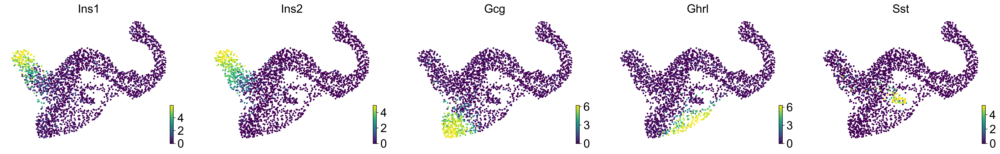

In [61]:
fig_kwargs = {'color':['Ins1', 'Ins2', 'Gcg', 'Ghrl', 'Sst'], 
              'perc':[0, 99], 'color_map': 'viridis',
             'dpi': 150}
if save_figure: fig_kwargs['save'] = f'marker_genes_1'
scv.pl.scatter(adata, **fig_kwargs)

saving figure to file /Users/marius/Projects/cellrank_notebooks_dev/figures//pancreas/20082020_ml_fig_2_pancreas/cellrank_fig2_marker_genes_2.pdf


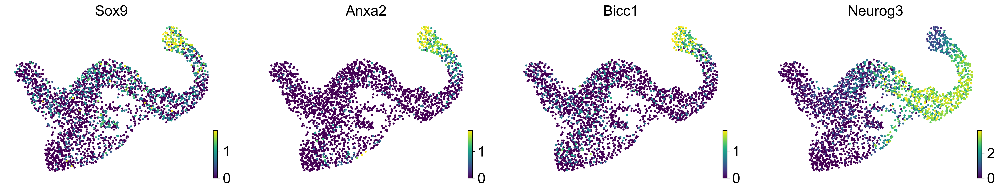

In [62]:
fig_kwargs = {'color':['Sox9', 'Anxa2', 'Bicc1', 'Neurog3'], 
              'perc':[0, 99], 'color_map': 'viridis',
             'dpi': 150}
if save_figure: fig_kwargs['save'] = f'marker_genes_2'
scv.pl.scatter(adata, **fig_kwargs)

We do the simplest possible thing: we look at known marker genes for the initial/terminal states and compute mean/median ranks over cell sets. 

Beta terminal state

In [63]:
_validate_state(adata, state_name='Beta', gene_list=['Ins1', 'Ins2', 'Nkx6-1'])

computing score 'Beta_score'
    finished (0:00:00)


28.5

Alpha terminal state

In [64]:
_validate_state(adata, state_name='Alpha', gene_list=['Gcg', 'Peg10', 'Irx2'])

computing score 'Alpha_score'
    finished (0:00:00)


39.5

Epsilon terminal state

In [65]:
_validate_state(adata, state_name='Epsilon', gene_list=['Ghrl', 'Irs4'])

computing score 'Epsilon_score'
    finished (0:00:00)


68.5

Initial state assignment: (we use ductal markers here)

In [66]:
_validate_state(adata, state_name='Ngn3 low EP', gene_list=['Sox9', 'Anxa2', 'Bicc1'], state_key='initial_states')

computing score 'Ngn3 low EP_score'
    finished (0:00:00)


nan

## Validate lineage probabilities by marker genes

In [67]:
beta_lin_markers = ['Myt1', 'Pax4', 'Gng12', 'Pdx1', 'Nkx6-1', 'Nkx6-2']
alpha_lin_markers = ['Peg10', 'Arx']
epsilon_lin_markers = ['Ghrl', 'Irs4']

In [68]:
fig_kwargs = {'color':['Pax4', 'Gng12', 'Peg10', 'Arx', 'Irs4', 'Hhex'], 'perc':[0, 99], 'color_map': 'viridis',
             'dpi': 400}
if save_figure: fig_kwargs['save'] = f'linege_driver_genes'
scv.pl.scatter(adata, **fig_kwargs)

saving figure to file /Users/marius/Projects/cellrank_notebooks_dev/figures//pancreas/20082020_ml_fig_2_pancreas/cellrank_fig2_linege_driver_genes.pdf


## Validate lineage probs by comparing with Fev+ subcl. 

For the subclusters Fev+ cells, we want to show agreement with the lineage probabilities. 

saving figure to file /Users/marius/Projects/cellrank_notebooks_dev/figures//pancreas/20082020_ml_fig_2_pancreas/cellrank_fig2_subclustering.pdf


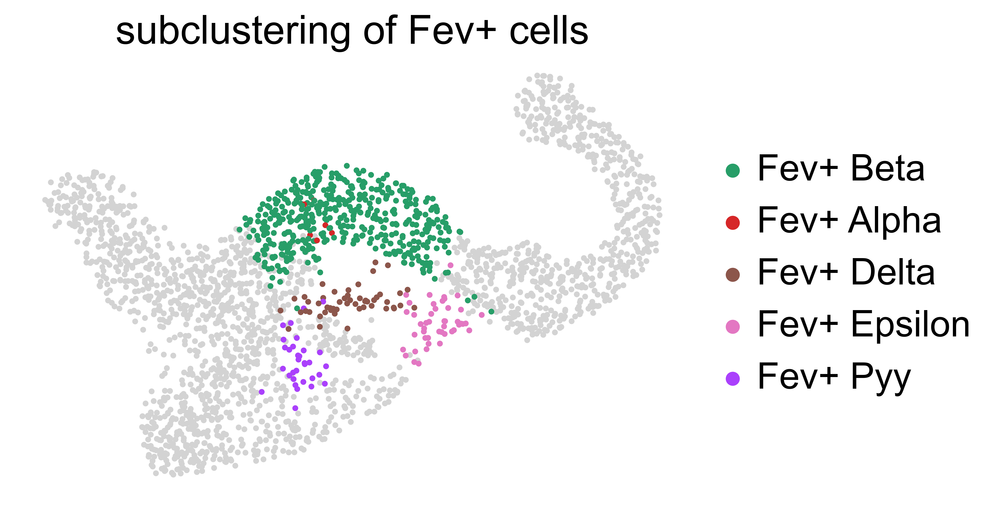

In [69]:
figure_kwargs = {'color': 'clusters_fine', 
                'legend_loc': 'right', 
                'groups': ['Fev+ Beta', 'Fev+ Alpha', 'Fev+ Delta','Fev+ Epsilon', 'Fev+ Pyy'],
                'title': f'subclustering of Fev+ cells', 'dpi': 400,
                }
if save_figure: figure_kwargs['save'] = f'subclustering'
scv.pl.scatter(adata, **figure_kwargs)

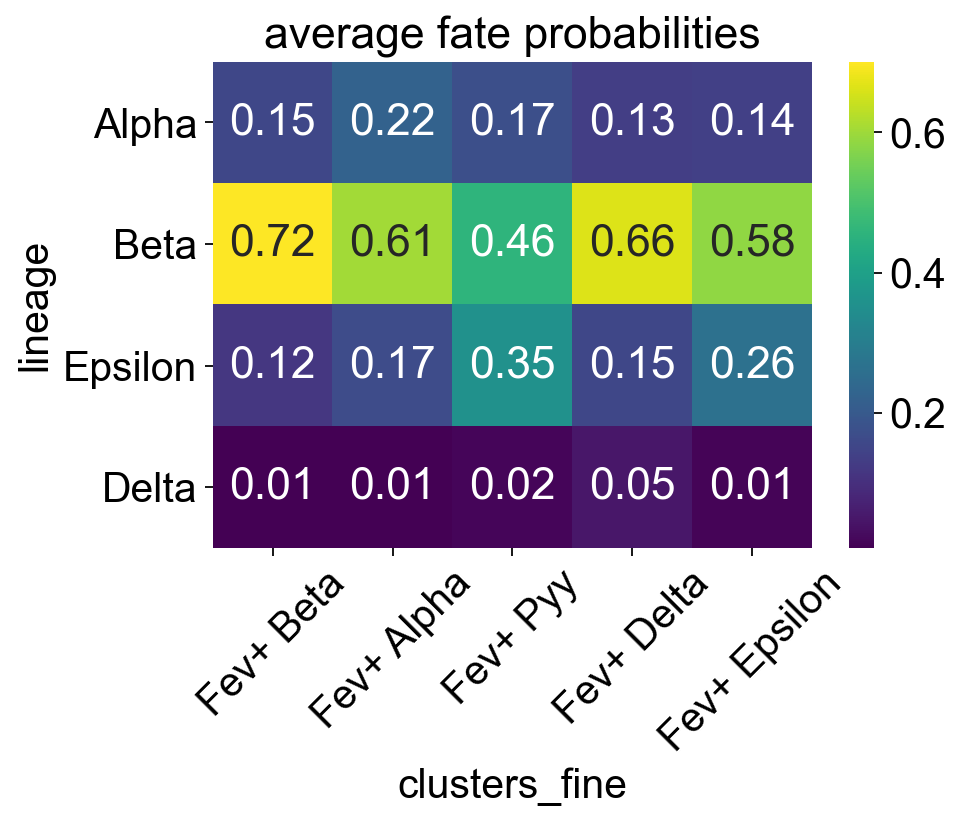

In [70]:
clusters = ['Fev+ Beta', 'Fev+ Alpha', 'Fev+ Pyy','Fev+ Delta', 'Fev+ Epsilon']

figure_kwargs = {'title': f'average fate probabilities', 
                 'lineages': ['Alpha', 'Beta', 'Epsilon', 'Delta'],
                 'cluster_key': 'clusters_fine',
                 'clusters': clusters,
                }
if save_figure: figure_kwargs['save'] = 'heatmap.pdf'

cr.pl.cluster_fates(adata, mode='heatmap', **figure_kwargs)

## Check lineage probabilities in Ngn3 high EP cells

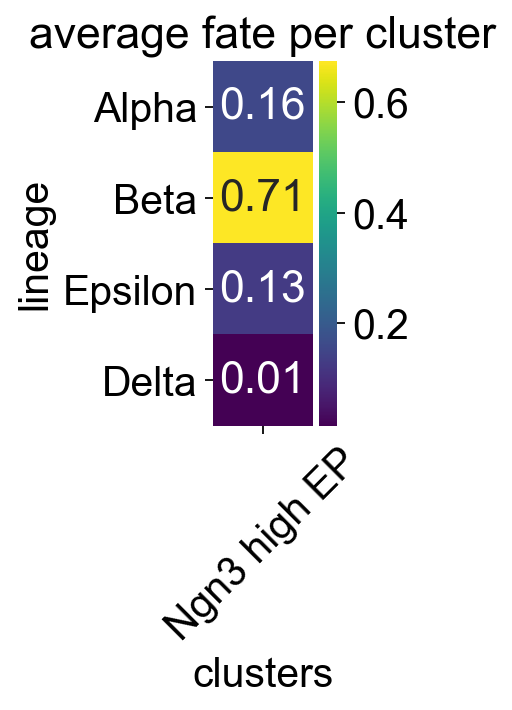

In [71]:
figure_kwargs = {'cluster_key': 'clusters', 'mode': 'heatmap', 
                 'lineages': ['Alpha', 'Beta', 'Epsilon', 'Delta'],
                'clusters': ['Ngn3 high EP'], 'figsize': (1, 3)}
if save_figure: figure_kwargs['save'] = 'heatmap_ngn3_high.pdf'
cr.pl.cluster_fates(adata, **figure_kwargs)